**Study the decision tree algorithm, focusing on both entropy based information gain and Gini index for splitting. Build decision trees and random forests for the loan datasets. As always, prepare three slides detailing problem description, data, technical approach, and results.**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import graphviz

In [2]:
loan_data=pd.read_excel('loan.xlsx')

In [3]:
loan_data.head(5)

,Sex,Age,Time_at_address,Res_status,Occupation,Job_status,Time_employed,Time_bank,Liab_ref,Acc_ref,Home_Expn,Balance,Decision
0,M,50.750000,0.585,owner,unemploye,unemploye,0,0,f,given,145,0,reject
1,M,19.670000,10.000,rent,labourer,governmen,0,0,t,given,140,0,reject
2,F,52.830002,15.000,owner,creative_,private_s,5,14,f,given,0,2200,accept
3,M,22.670000,2.540,rent,creative_,governmen,2,0,f,given,0,0,accept
4,M,29.250000,13.000,owner,driver,governmen,0,0,f,given,228,0,reject


In [4]:
loan_data.head()
#loan_data.drop(columns='Telephone',inplace=True)

,Sex,Age,Time_at_address,Res_status,Occupation,Job_status,Time_employed,Time_bank,Liab_ref,Acc_ref,Home_Expn,Balance,Decision
0,M,50.750000,0.585,owner,unemploye,unemploye,0,0,f,given,145,0,reject
1,M,19.670000,10.000,rent,labourer,governmen,0,0,t,given,140,0,reject
2,F,52.830002,15.000,owner,creative_,private_s,5,14,f,given,0,2200,accept
3,M,22.670000,2.540,rent,creative_,governmen,2,0,f,given,0,0,accept
4,M,29.250000,13.000,owner,driver,governmen,0,0,f,given,228,0,reject


In [5]:
X=loan_data.iloc[:,:-1]
Y=loan_data.iloc[:,-1]

In [6]:
print(loan_data['Sex'].unique(),loan_data['Res_status'].unique(),loan_data['Occupation'].unique(),loan_data['Job_status'].unique(),loan_data['Acc_ref'].unique())

['M' 'F'] ['owner' 'rent'] ['unemploye' 'labourer' 'creative_' 'driver' 'professio' 'manager'
 'guard_etc' 'executive' 'office_st' 'productio' 'semi_pro' 'sales'] ['unemploye' 'governmen' 'private_s' 'self_empl' 'retired' 'student'
 'military'] ['given' 'oth_inst_']


In [7]:
one_hot_encoded_data =pd.DataFrame()
x = pd.get_dummies(X, columns = ['Sex','Res_status','Occupation','Job_status','Acc_ref','Liab_ref'])

In [8]:
features = x.columns
x

,Age,Time_at_address,Time_employed,Time_bank,Home_Expn,Balance,Sex_F,Sex_M,Res_status_owner,Res_status_rent,...,Job_status_military,Job_status_private_s,Job_status_retired,Job_status_self_empl,Job_status_student,Job_status_unemploye,Acc_ref_given,Acc_ref_oth_inst_,Liab_ref_f,Liab_ref_t
0,50.750000,0.585,0,0,145,0,0,1,1,0,...,0,0,0,0,0,1,1,0,1,0
1,19.670000,10.000,0,0,140,0,0,1,0,1,...,0,0,0,0,0,0,1,0,0,1
2,52.830002,15.000,5,14,0,2200,1,0,1,0,...,0,1,0,0,0,0,1,0,1,0
3,22.670000,2.540,2,0,0,0,0,1,0,1,...,0,0,0,0,0,0,1,0,1,0
4,29.250000,13.000,0,0,228,0,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,34.169998,2.750,2,0,232,200,0,1,1,0,...,0,0,0,1,0,0,1,0,0,1
425,22.250000,1.250,3,0,280,0,1,0,0,1,...,0,0,0,0,0,1,1,0,1,0
426,23.330000,1.500,1,0,422,200,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
427,21.000000,4.790,2,1,80,300,0,1,0,1,...,0,1,0,0,0,0,1,0,0,1


In [9]:
loan_data.isna().sum()

Sex                0
Age                0
Time_at_address    0
Res_status         0
Occupation         0
Job_status         0
Time_employed      0
Time_bank          0
Liab_ref           0
Acc_ref            0
Home_Expn          0
Balance            0
Decision           0
dtype: int64

In [10]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
y=le.fit_transform(Y)

In [11]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test=train_test_split(x,y,test_size=0.25,random_state=1)

**Using Entropy Menthod in Decision Tree**

In [12]:
#using entropy as a measure of impurity for spliting in the decision tree 
from sklearn import tree
data_entropy = tree.DecisionTreeClassifier(criterion='entropy')

In [13]:
data_entropy = data_entropy.fit(X_train,Y_train)

In [14]:
y_pred = data_entropy.predict(X_test)
y_pred

array([1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0,
       1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1,
       0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1,
       1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0,
       1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1])

In [15]:
result_entropy=pd.DataFrame()
result_entropy['Y_test']=Y_test
result_entropy['Predicted Result']=y_pred
result_entropy

,Y_test,Predicted Result
0,1,1
1,0,1
2,1,1
3,0,1
4,0,0
...,...,...
103,1,1
104,1,1
105,0,1
106,1,0


In [16]:
from sklearn.metrics import accuracy_score
print(accuracy_score(Y_test, y_pred))

0.6666666666666666


In [17]:
data_entropy.feature_importances_

array([0.06636961, 0.1183415 , 0.12604313, 0.24954061, 0.10759075,
       0.12205981, 0.01610757, 0.        , 0.        , 0.01506698,
       0.        , 0.00756546, 0.        , 0.01594172, 0.0102829 ,
       0.        , 0.01308842, 0.01537031, 0.01104896, 0.02709116,
       0.02651097, 0.        , 0.        , 0.        , 0.00794691,
       0.01486123, 0.01312398, 0.        , 0.        , 0.        ,
       0.00602102, 0.01002698, 0.        ])

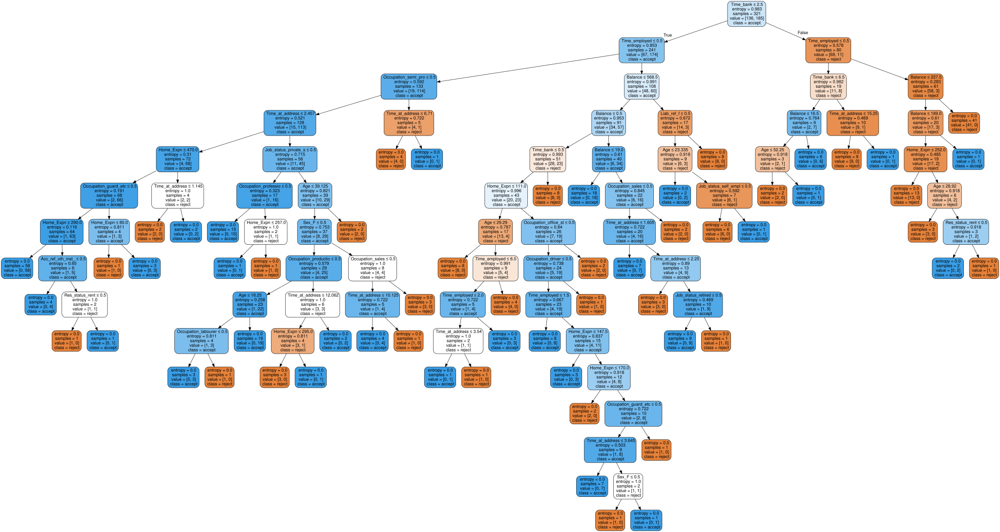

In [18]:
data = tree.export_graphviz(data_entropy, out_file=None, 
                      filled=True,feature_names=features,class_names=['reject','accept'], rounded=True,  
                      special_characters=True)  
graph = graphviz.Source(data)
graph.render('Decision Tree Entropy')  
graph

In [19]:
#dot_data = tree.export_graphviz(dt_entropy, out_file=None, 
                      #filled=True,feature_names=features,class_names=['reject','accept'], rounded=True,  
                      #special_characters=True)  
#graph = graphviz.Source(dot_data)  
#graph
#graph.render('diagram')

**Using Gini method in Descision Tree**

In [20]:
dt_gini=tree.DecisionTreeClassifier(criterion='gini')

In [21]:
dt_gini.fit(X_train,Y_train)

DecisionTreeClassifier()

In [22]:
y_pred2=dt_gini.predict(X_test)

In [23]:
result_gini=pd.DataFrame()
result_gini['Y_test']=Y_test
result_gini['Predicted Result'] = y_pred2
result_gini

,Y_test,Predicted Result
0,1,1
1,0,1
2,1,1
3,0,1
4,0,0
...,...,...
103,1,1
104,1,1
105,0,0
106,1,1


In [24]:
from sklearn.metrics import accuracy_score
print(accuracy_score(Y_test, y_pred2))

0.6759259259259259


In [25]:
dt_gini.feature_importances_

array([0.04584362, 0.13047334, 0.11869489, 0.3247488 , 0.10165173,
       0.12620208, 0.00191375, 0.        , 0.00637917, 0.00956876,
       0.01378797, 0.00834377, 0.        , 0.        , 0.        ,
       0.00567038, 0.01476206, 0.00170111, 0.01957997, 0.00162327,
       0.02862369, 0.        , 0.00478438, 0.        , 0.01275835,
       0.        , 0.001625  , 0.        , 0.        , 0.02126391,
       0.        , 0.        , 0.        ])

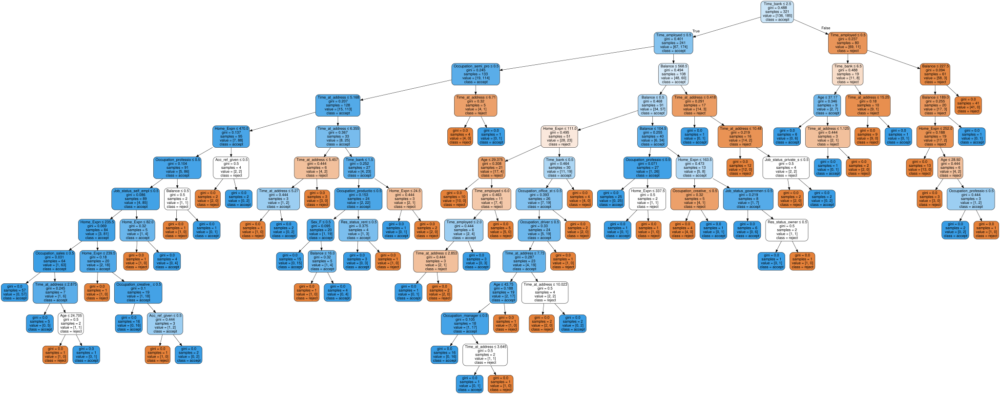

In [41]:
data_1 = tree.export_graphviz(dt_gini, out_file=None, 
                      filled=True,feature_names=features,class_names=['reject','accept'], rounded=True,  
                      special_characters=True, )  
graph = graphviz.Source(data_1)  
graph.render('Decision Tree Gini Method')
graph

**Random Forest Implementation**

In [27]:
from sklearn.ensemble import RandomForestClassifier

**Gini Method**

In [28]:
clf=RandomForestClassifier(n_estimators=1000,criterion='gini')

In [29]:
clf.fit(X_train,Y_train)

RandomForestClassifier(n_estimators=1000)

In [30]:
y_pred_RandomForest=clf.predict(X_test)

In [31]:
from sklearn import metrics
print("Accuracy:",metrics.accuracy_score(Y_test, y_pred_RandomForest))
print(metrics.classification_report(Y_test,y_pred_RandomForest))

Accuracy: 0.7592592592592593
              precision    recall  f1-score   support

           0       0.94      0.57      0.71        56
           1       0.68      0.96      0.79        52

    accuracy                           0.76       108
   macro avg       0.81      0.77      0.75       108
weighted avg       0.81      0.76      0.75       108



In [39]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(nrows = 1,ncols = 2,figsize = (10,7), dpi = 3000)
for index in range(0, 2):
    tree.plot_tree(clf.estimators_[index], feature_names = features,class_names=['reject','accept'],filled = True,ax = axes[index]);
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
fig.savefig('Random Forest Gini')    

**Entropy Method**

In [ ]:
clf_entropy=RandomForestClassifier(criterion='entropy')

In [ ]:
clf_entropy.fit(X_train,Y_train)

In [ ]:
y_pred_entropy=clf_entropy.predict(X_test)

In [ ]:
from sklearn import metrics
print("Accuracy:",metrics.accuracy_score(Y_test, y_pred_entropy))
print(metrics.classification_report(Y_test,y_pred_entropy))


In [38]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(nrows = 1,ncols = 2,figsize = (10,5), dpi=3000)
for index in range(0,2):
    tree.plot_tree(clf_entropy.estimators_[index],feature_names = features, class_names=['reject','accept'],filled = True, ax = axes[index]);
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
fig.savefig('Random Forest Entropy')